# Análise Exploratória de Dados (EDA)

In [2]:
import pandas as pd
import os
import matplotlib.pyplot as plt 
import seaborn as sns 
import numpy as np
from folium.plugins import HeatMap 
import folium

In [3]:
path = os.path.join('..','data','processed','datatran.pkl')
data = pd.read_pickle(path)

In [4]:
data = pd.concat([
    data[~data['pesid'].isna()].drop_duplicates(subset=['id','pesid']),
    data[data['pesid'].isna()]
], ignore_index=True)

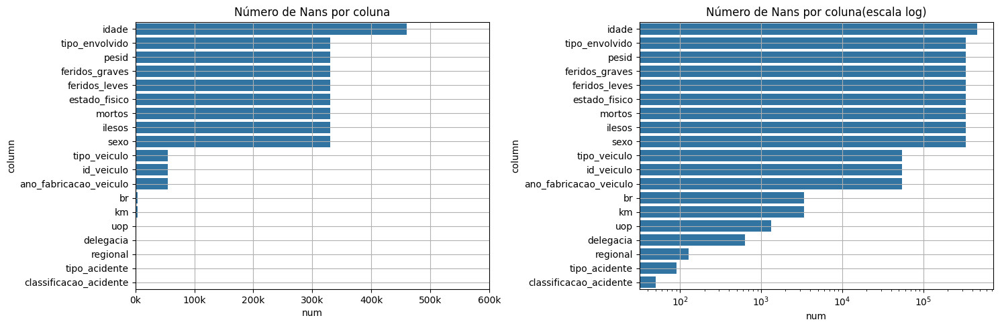

In [5]:
fig,axes = plt.subplots(1,2,figsize=(15,5))
axes.flatten()
na_data = data.isna().sum().reset_index()
na_data.columns = ['column','num']
sns.barplot(na_data.query('num>0').sort_values(by='num',ascending=False),x='num',y='column',ax=axes[0])
axes[0].set_title('Número de Nans por coluna')
axes[0].set_xticks(range(0,600001,100000),[str(x)+'k' for x in range(0,601,100)])
axes[0].grid(True)
sns.barplot(na_data.query('num>0').sort_values(by='num',ascending=False),x='num',y='column',ax=axes[1])
axes[1].set_title('Número de Nans por coluna(escala log)')
axes[1].set_xticks(range(0,600001,100000),[str(x)+'k' for x in range(0,601,100)])
axes[1].grid(True)
axes[1].set_xscale('log')
plt.tight_layout()
plt.show()

In [6]:
# Teste para ver se para cada acidente, os valores de cada pessoa varia no mesmo acidente
# Importante para ver se é selecionar os dados
# Observação, os nas foram removidos, porque não tem utilidade aqui
cols = ['idade','ilesos','feridos_leves','feridos_graves','mortos','id_veiculo']
temp = data.dropna(subset=['pesid'])
temp = temp.groupby(['id','pesid']).agg({x:'nunique' for x in cols})
temp.query(' or '.join(col+'>1' for col in cols))
#Não retorna nehuma coluna

,,idade,ilesos,feridos_leves,feridos_graves,mortos,id_veiculo
id,pesid,,,,,,


In [7]:
# Aqui é selecionado apenas os dados dos pacientes, sem os dados do acidente, que pode ser obtido
# com a coluna id. Os pesid foram removidos, porque não fazem sentido manter eles, porque
# a mesma pessoa com pesid Nan pode repetir diversas vezes.
pessoas = data[['id','pesid','sexo','idade']+cols]
pessoas = pessoas.dropna(subset=['pesid'])
pessoas.drop_duplicates()
# Lembrando que estes dados podem envolver pessoas repetidas, desde que a mesma pessoa apareça em acidentes diferentes

,id,pesid,sexo,idade,idade,ilesos,feridos_leves,feridos_graves,mortos,id_veiculo
0,8,1,masculino,19,19,0,0,1,0,5
1,9,955,masculino,35,35,1,0,0,0,7
2,11,2,feminino,27,27,0,1,0,0,6
3,11,3,masculino,27,27,0,1,0,0,6
4,12,1499,masculino,24,24,0,0,1,0,8
...,...,...,...,...,...,...,...,...,...,...
1331963,661598,1491839,nao informado,<NA>,<NA>,0,0,0,0,<NA>
1331964,661607,1491859,masculino,33,33,1,0,0,0,1190283
1331965,661607,1491861,masculino,124,124,0,0,1,0,1190282
1331966,661607,1491860,feminino,124,124,0,1,0,0,1190282


In [8]:
# Número total de acidentes
print('Número total de acidentes',len(data[data['id'].duplicated()]['id']))
# Aqui estou verficando se para cada acidente os valores em col se mantém constante
cols = ['data','latitude','longitude','fase_dia','condicao_metereologica']
temp = data.groupby(['id']).agg({x:'nunique' for x in cols})
temp.query(' or '.join(x+'>1' for x in cols))
# como é possivel ver existe um acidente que tem duas latitude e longitudes
# se voce olhar no id especifico, voce pode ver que a diferenças são neste 
# acidente é insgnificante

Número total de acidentes 1102097


,data,latitude,longitude,fase_dia,condicao_metereologica
id,,,,,
76911,1,2,2,1,1


In [9]:
# aqui é eliminado todos os acidentes que tem pelo menos uma pessoa com pesid Nan

acidentes = data.dropna(subset='pesid').copy()
acidentes.loc[:,'causas_principais'] = acidentes.apply(lambda r: r['tipo_acidente'] if r['causa_principal']=='sim' else np.nan,axis=1)
acidentes = acidentes.groupby(['id']).agg({
    'id':'first',
    'data':'first',
    'fase_dia':'first',
    'condicao_metereologica':'first',
    'latitude':'first',
    'longitude':'first',
    'ilesos':'sum',
    'feridos_leves':'sum',
    'feridos_graves':'sum',
    'mortos':'sum',
    'causas_principais': lambda x: x.dropna().tolist()
})
acidentes['causas_principais'] = acidentes['causas_principais'].apply(lambda x:','.join(x))

## Distribuição geografica dos acidentes

In [10]:
# Aqui eu considero todos os acidentes
# mesmo aqueles que não adicionei no dataframe acidentes
coords = data.groupby(['id']).agg({'latitude':'first','longitude':'first'}).reset_index()
coords = coords[['latitude','longitude']]
geomap = folium.Map(location=[-14,-51],zoom_start=4)
HeatMap(data[['latitude','longitude']],radius=15).add_to(geomap)
geomap

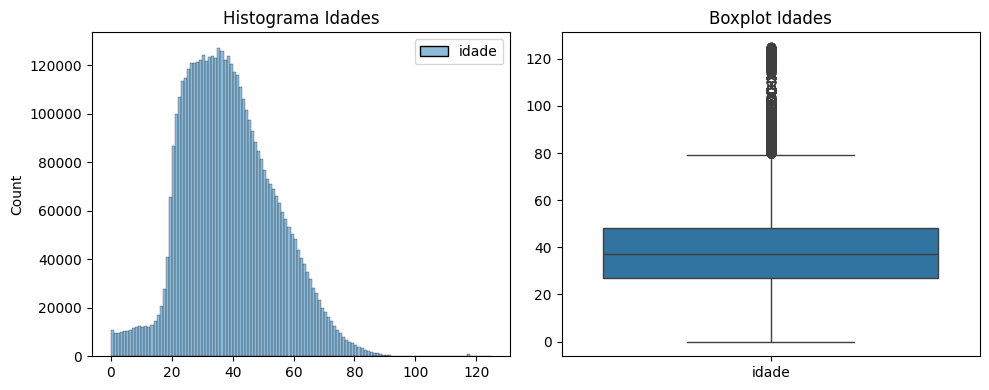

In [ ]:
fig,axes = plt.subplots(1,2,figsize=(10,4))
axes = axes.flatten()
idades = pessoas['idade']
sns.histplot(idades,bins=range(0,126),ax=axes[0])
axes[0].set_title('Histograma Idades')
sns.boxplot(idades,ax=axes[1])
axes[1].set_title('Boxplot Idades')

plt.tight_layout()
plt.show()

No `dataprep.ipynb`, eu transformei todas as idades maiores que 125 em `NaN`, mas ainda assim existem muitos outliers, como mostrado no segundo gráfico.

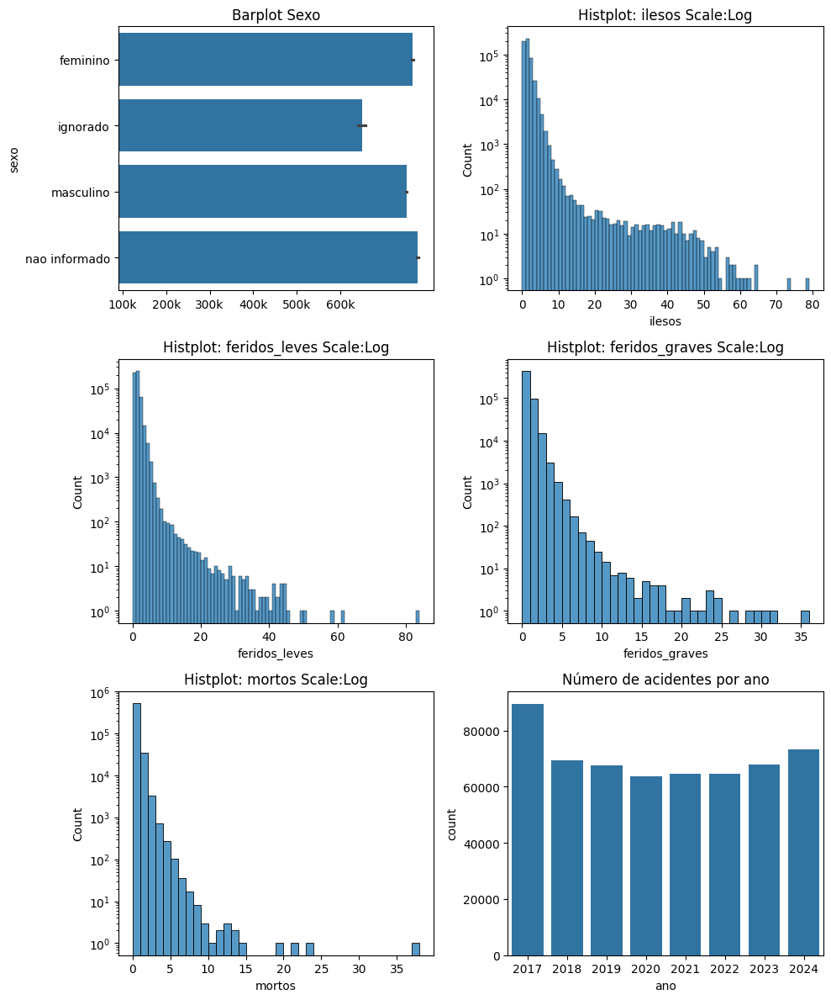

In [ ]:
sexos = pessoas['sexo']
fig,axes = plt.subplots(3,2,figsize=(10,12))
axes=axes.flatten()
sns.barplot(sexos,ax=axes[0])
axes[0].set_title('Barplot Sexo (Todas as pessoas envolvidas nos acidentes)')
axes[0].set_xticks(range(10000,600001,100000))
axes[0].set_xticklabels([str(x)+'k' for x in range(100,601,100)])
for i,x in enumerate(['ilesos','feridos_leves','feridos_graves','mortos']):
    col = acidentes[x]
    g = axes[i+1]
    sns.histplot(col,bins=range(col.min(),col.max()+2),ax=g)
    g.set_title('Histplot: '+x+' Scale:Log')
    g.set_yscale('log')

acidentes_por_ano = data.groupby(['id']).agg({'data':'first'})
acidentes_por_ano['ano'] = acidentes_por_ano['data'].dt.year
acidentes_por_ano = acidentes_por_ano['ano'].value_counts()
sns.barplot(acidentes_por_ano,ax=axes[5])
axes[5].set_title('Número de acidentes por ano')

plt.tight_layout()
plt.show()

In [47]:
# aqui crio um dataframe gacidentes, não tem dados de ilesos,feridos_leves,feridos_gras,mortos mas é
# uma versão mais completa dos acidentes
gacidentes = data[['id','fase_dia','condicao_metereologica','latitude','longitude','data']]
gacidentes = gacidentes.groupby(['id']).agg({
    'fase_dia':'first',
    'condicao_metereologica':'first',
    'latitude':'first',
    'longitude':'first',
    'data':'first',
}).reset_index()

C:\Users\Carlos\AppData\Local\Temp\ipykernel_7808\3050868611.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp = gacidentes.groupby(['fase_dia']).agg({'id':'count'}).reset_index()


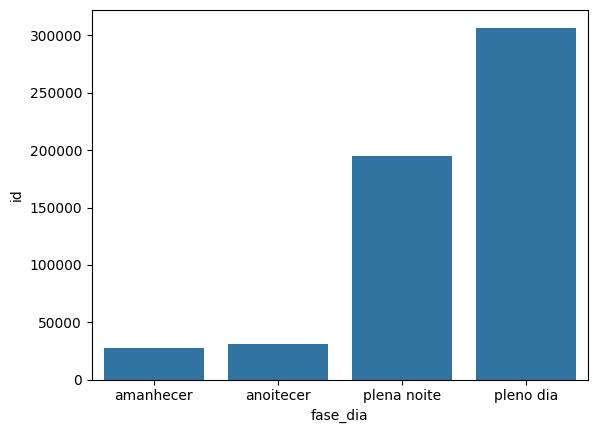

C:\Users\Carlos\AppData\Local\Temp\ipykernel_7808\3050868611.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp = gacidentes.groupby(['condicao_metereologica']).agg({'id':'count'}).reset_index()


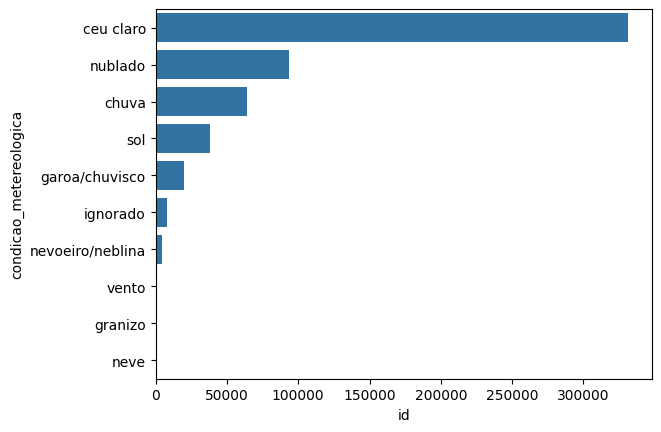

In [76]:
temp = gacidentes.groupby(['fase_dia']).agg({'id':'count'}).reset_index()
sns.barplot(temp,x='fase_dia',y='id')
plt.show()
temp = gacidentes.groupby(['condicao_metereologica']).agg({'id':'count'}).reset_index()
sns.barplot(temp,y='condicao_metereologica',x='id',order=temp.sort_values('id',ascending=False)['condicao_metereologica'])
plt.show()

<Axes: xlabel='dia', ylabel='count'>

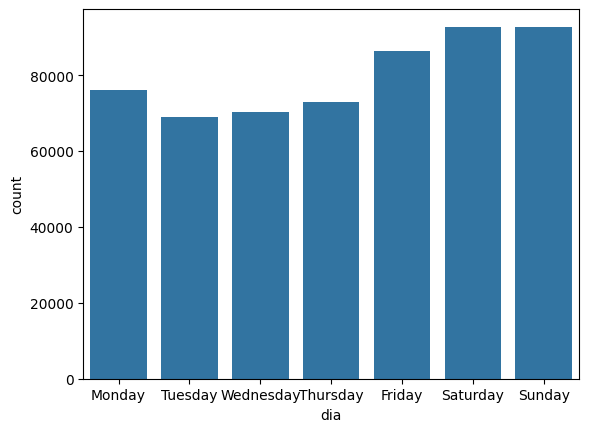

In [80]:
gacidentes['dia'] = gacidentes['data'].dt.day_name()
order = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']
sns.barplot(gacidentes['dia'].value_counts(),order=order)
